# Pregunta 2


## ¿Podemos utilizar representaciones vectoriales apropiadas de los tweets y encontrar modelos descriptivos de agrupamiento de datos como clustering capaces de relacionar más aquellos tweets asociados a un mismo emoji?

## Preámbulo
El paradigma tradicional de representación vectorial de datos ha sido través de un diseño manual de atributos. 
En Procesamiento del Lenguaje Natural (PLN) existen varias aproximaciones para representar vectorialmente el texto. 
Métodos como Bag-of-word y tf-idf son formas rudimentarias de codificar la información del texto. 
Mientras que el uso de word-embeddings como word2vec y modelos del lenguaje como BERT son formas más sofisticadas de hacer lo mismo. 
Pero esta vez, aprovechándose de propiedades más complejas del texto. 
En nuestro caso, nos interesa explorar distintas aproximaciones que puedan vectorizar apropiadamente un tweet. 
Por otro lado, cada uno de los tweets de la base de datos posee un único emoji asociado. 
El emoji es una de las tantas características comunes que relacionan a los tweets. 
Hay características desde simples hasta complejas de detectar. 
Una característica simple que nos permite agrupar los tweet es la cantidad de palabras que poseen. 
Con esto, podemos tener dos grupos: aquellos con (1) varias palabras y (2) pocas palabras. 
Características complejas suelen ser más difíciles de detectar, como lo es el sentimiento de un tweet. 
Así, podemos tener tres grupos: aquellos con sentimiento (1) positivo, (2) neutro y (3) negativo. 
Ahora bien, estamos interesados en explorar distintos algoritmos de clustering con el objetivo de encontrar aquellos mas apropiados.
Es decir, que sean capaces de traducir grupos diferenciados según el único emoji presente en el tweet tanto para inglés como para español. 
Entre los algoritmos a explorar estan: k-means, aglomerativo, gaussian mixtures, dbscan y optics.

## Propuesta metodológica

En lo que sigue se detallara la propuesta metodológica ilustrada en la **Figura 1.**

**Figura 1.** *Diagrama de trabajo para analisis de clustering*

<img src="p2_clustering.png" alt="drawing" width="600"/>

Primero, nuestro conjunto de datos esta separado por idioma (Ingles y Español) y por particion de ajuste (Entrenamiento/Evaluacion/Prueba). Cada dato consiste en un tweet junto a su etiqueta (indice asociado al emoji). Ahora bien, para utilizar algoritmos de clustering es necesario representar vectorialmente cada tweet. Para esto, consideramos cinco metodos. Tres de estos sirve tanto para Ingles como para Español. Estos son: bag-of-word, tf-idf y word2vec. Luego, para Español consideramos BETO (BERT pero entrenado con un corpus en español). Mientras que para Ingles, consideramos BERTweet (BERT pero entrenado con tweets en ingles). Ver **Tabla 1.** para mas detalles de estos metodos. Brevemente, los primeros dos metodos siguen la forma tradicional de representacion de texto. Mientras que los demas, siguen el paradigma de aprendizaje de representaciones. Estas representaciones provienen de capa especificas en redes neuronales. Por otro lado, aquellos inspirados en BERT, siguen el paradigma de aprendizaje profundo.

**Tabla 1.** *Representación del tweet*

|       Notación    |   Método      |  🇺🇸     |   🇪🇸    | Libreria |
|-------------------|---------------|---------|--------|----------|
|       BOW         | [bag-of-words](https://en.wikipedia.org/wiki/Bag-of-words_model)                                                            |  ✔️   |   ✔️   | [sklearn](https://scikit-learn.org/stable/modules/feature_extraction.html#the-bag-of-words-representation)|
|       TFIDF       | [term-frecuency invert-document-frecuency](https://en.wikipedia.org/wiki/Tf%E2%80%93idf)                                    |  ✔️    |   ✔️   | [sklearn](https://scikit-learn.org/stable/modules/feature_extraction.html#tfidf-term-weighting)           |
| W2V               | [Word2vec](https://en.wikipedia.org/wiki/Word2vec)                                                                          | ✔️     | ✔️     | [gensim](https://radimrehurek.com/gensim/models/word2vec.html)                                            |
|       BETO        | [BETO: Spanish BERT](https://github.com/dccuchile/beto)                                                                     |       |   ✔️   | [🤗](https://huggingface.co/dccuchile/bert-base-spanish-wwm-cased)                                |
|       BERTweet    | [BERTweet: A pre-trained language model for English Tweets](https://aclanthology.org/2020.emnlp-demos.2/)                   |  ✔️    |       | [🤗](https://huggingface.co/vinai/bertweet-base)                                                  |

Luego de representar cada tweet como un vector con alguno de los metodos propuestos, consideramos cinco algoritmos distintos para agrupar los datos en clusters. Estos son: k-means, Jerarquico aglomerativo, dbscan, optics y Mixturas Gaussianas. Ver **Tabla 2.** para mas detalle. Se indicaran tantos clusters como emojis, siempre que el metodo lo permita. La idea es encontrar el metodo mas apropiado para nuestra tarea principal (predecir el emoji). Es decir, aquel que mejor agrupe aquellos tweets asociados a un mismo emoji y, al mismo tiempo, distinguir aquellos tweets asociado a un emoji diferente. Para medir esto finalizamos con una evaluacion y visualizacion del clustering.

**Tabla 2.** *Algoritmos de clustering*

|       Notación    |   Método      | param: #(clusters) |  Libreria |
|-------------------|---------------|------|---------|
| kMeans           | [k-means](https://en.wikipedia.org/wiki/K-means_clustering)           | ✔️ |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) |
| Agg      | [Agglomerative Hierarchical](https://en.wikipedia.org/wiki/Hierarchical_clustering)      | ✔️ |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering) |
| DBSCAN            | [Density-based spatial clustering of applications with noise](https://en.wikipedia.org/wiki/DBSCAN)            | |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html#sklearn.cluster.DBSCAN) | 
| OPTICS            | [Ordering points to identify the clustering structure](https://en.wikipedia.org/wiki/OPTICS_algorithm)      |  | [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.OPTICS.html#sklearn.cluster.OPTICS) |
| GM  | [Gaussian Mixture](https://en.wikipedia.org/wiki/Mixture_model#Gaussian_mixture_model)  | ✔️ |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html#sklearn.mixture.GaussianMixture) |

Para evaluar cuantitativamente el clustering, consideramos siete metricas. Como se tienen las etiquetas correctas de los puntos, entonces podemos considerar metricas similares a Accuracy, Precision, Recall y F1-score, para evaluar los clusters. Estas metricas son: Rand index, Mutual Information, Homogeneity, Completeness y V-measure. Por otro lado, consideramos dos metricas adicionales que no requieren etiquetas correctas: Matriz de correlacion y Silhouette. Ver **Tabla 3.** para mas detalle.

**Tabla 3.** *Métricas de evaluación para clustering. El simbolo 🔒 indica que es necesaria dicha información para calcular la metrica*

|       Notación    |   Método               | Rango  | Ground truth (Etiquetas)    | kMeans | Agg | DBSCAN | OPTICS | GM |  Libreria |
|-------------------|------------------------|--------|-----------------------------|--------|-----|--------|--------|----|-----------|
|      Corr         | [Correlación (Pearson)](https://en.wikipedia.org/wiki/Pearson_correlation_coefficient)                        | [-1, 1]^n   |       ✔️       |   ✔️    |  ✔️  |   ✔️    |   ✔️    | ✔️  |     [🐼](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.corr.html)      |
|      SC           | [Silhouette](https://en.wikipedia.org/wiki/Silhouette_(clustering))                                           | [-1, 1]   |       ✔️       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |   [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html#sklearn.metrics.silhouette_score)        |
|      Rand         | [Rand index](https://en.wikipedia.org/wiki/Rand_index)                                                        |  [0, 1]  |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.rand_score.html#sklearn.metrics.rand_score)        |
| NMI               | [Mutual Information](https://en.wikipedia.org/wiki/Mutual_information#Normalized_variants)                          | [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.normalized_mutual_info_score.html#sklearn.metrics.normalized_mutual_info_score)        |
| Hom               | [Homogeneity](https://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure) | [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.homogeneity_score.html#sklearn.metrics.homogeneity_score)        |
| Comp              | [Completeness](https://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure)| [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.completeness_score.html#sklearn.metrics.completeness_score)        |
| V                 | [V-measure](https://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure)   | [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.v_measure_score.html#sklearn.metrics.v_measure_score)        |


Ahora bien, para evaluar cualitativamente el clustering, se visualizaran los clusters obtenidos. Sin embargo, como los vectores viven en espacios de dimensiones mayores que dos, es necesario reducir la dimensionalidad de los vectores. Para esto, consideramos tres metodos distintos. Estos son: PCA, tSNE y UMAP. Ver **Tabla 4.** para mas detalle. La idea, es reducirnos a dimensiones interpretables como 2- y 3-dimensiones.

**Tabla 4.** *Reductores de dimensionalidad*

|       Notación    |   Método               | Libreria |
|-------------------|------------------------|----------|
|      PCA          | [Principal component analysis](https://en.wikipedia.org/wiki/Principal_component_analysis)  |   [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)       |
|      tSNE         | [t-Distributed Stochastic Neighbor Embedding](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)  | [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html) |
|      UMAP         | [Uniform Manifold Approximation and Projection](https://arxiv.org/abs/1802.03426) | [📄](https://umap-learn.readthedocs.io/en/latest/) |

Finalmente, este analisis nos dara un entendimento de la dificultad de predecir un emoji. Si los datos no se expresan en grupos diferenciados por el emoji, es decir, que se solapan los grupos de datos para emojis distintos. Entonces, modelos de clasificacion tenderan a obtener un desempeño deficiente. Por otro lado, con esta informacion podremos encontrar otro grupos (distintos a los indicados por el emoji) que pudiesen existir en el conjunto de datos. En cambio, si los datos logran expresarse para cierta representacion del texto junto a un metodo de clustering particular, responderemos afirmativamente la pregunta.

# Resultados

## Tabla de contenidos
* [Análisis para Español](#Análisis-para-Español)
    * [Cargar y preparar los resultados](#Cargar-y-preparar-los-resultados:-ES)
    * [Análisis Cuantitativo](#Análisis-Cuantitativo:-ES)
    * [Análisis Cualitativo](#Análisis-Cualitativo:-ES)
        * [Matriz de distancias](#Matriz-de-distancias:-ES)
        * [Proyecciones 2D](#Proyecciones-2D:-ES)
            * [UMAP](#UMAP:-ES)
            * [TSNE](#TSNE:-ES)
            * [PCA](#PCA:-ES)
* [Análisis para Ingles](#Análisis-para-Ingles)
    * [Cargar y preparar los resultados](#Cargar-y-preparar-los-resultados:-US)
    * [Análisis Cuantitativo](#Análisis-Cuantitativo:-US)
    * [Análisis Cualitativo](#Análisis-Cualitativo:-US)
        * [Matriz de distancias](#Matriz-de-distancias:-US)
        * [Proyecciones 2D](#Proyecciones-2D:-US)
            * [UMAP](#UMAP:-US)
            * [TSNE](#TSNE:-US)
            * [PCA](#PCA:-US)
* [Conclusion](#Conclusion)

## Análisis para Español

En esta sección analizaremos lo resultados obtenido con el conjunto de datos en español para los distintos métodos de representación de tweets y métodos de clustering.

El analisis se separara en dos secciones, (1) analisis cuantitativo y (2) cualitativo. Para (1) se estudiaran las metricas Silhouette, Rand score, Mutual information, Completeness, Homogeneity y V-measure. Mientras que para (2) se validaran la matriz de distancias y visualizacion de cluster con tres metodos de reduccion de dimensionalidad. Esto son: PCA, TSNE y UMAP.

### Cargar y preparar los resultados: ES

*Jupyter notebooks.* En la tabla de abajo se encuentran los notebooks utilizados para obtener los resultados para cada método de representación de tweets.


|Representación      |   Notebook (HTML)     |
|----------------------------|-------------|
| BOW                        |[📄](notebooks_clustering/clusterings_usando_bow_ES.html)       |
| TF-IDF                     |[📄](notebooks_clustering/clusterings_usando_tfidf_US.html)       |
| word2vec                   |[📄](notebooks_clustering/clusterings_usando_w2v_ES.html)       |
| BETO   |[📄](notebooks_clustering/clusterings_usando_beto_ES.html)|

In [1]:
import config_p2

Cargamos los resultados:

In [2]:
root_file = "/github/data-mining-2022/Hitos/H3/notebooks_clustering"
es_array_paths = config_p2.get_array_paths(root_file, lang="ES")
df_es_train, labels_es, sample_index_es = config_p2.get_data("../../Data/train/df_es_train.pickle", lang="ES")

### Análisis Cuantitativo: ES

En lo que sigue se estudiaran las metricas cuantitativas (Silhouette, Rand score, Mutual information, Completeness, Homogeneity y V-measure) en funcion del método de respresentación de tweets y método de clustering.

In [3]:
df_es_results = config_p2.get_df_results(root_file, es_array_paths, lang="ES")

#### Silhouette

In [4]:
config_p2.plot_metric(df_es_results, metric="Silhouette", lang="ES")

**Observaciones**

Los resultados obtenidos con DBSCAN son engañosos. Ya que en general el número de clusters que obtiene automatico varian entre 1 y tres clusters. Por esta razon, los clusters que obtiene son mejores definidos e incluso disjuntos en comparacion al resto de metodos de clustering. 

Cuando dejamos de lado a DBSCAN, se observa que word2vec (w2v) obtiene mejores valores para HC y KMeans. Por otro lado, podemos notar que con tf-idf, los resultados son pesimos. Lo ultimo se debe a que los clusters obtenidos estan mezclados entre si y no separados ni bien definidos.

#### Rand score
Rand score es una métrica que nos permite el grado de acuerdo entre los clusters con las etiquetas reales de los datos. En simples palabras, es el acuraccy del metodo de clustering. 

In [5]:
config_p2.plot_metric(df_es_results, metric="Rand score", lang="ES")

**Observaciones**

Podemos observar que para todos los tipos de representaciones de tweets, el método de clustering DBSCAN posee un Rand score considerablemente menor que el resto de métodos. Esto se debe a que DBSCAN encuentra automaticamente un numero de cluster optimo (2 y 3) menor que el numero de emojis (19 en español). Es decir, la mayoria de los tweets son agrupados en no más de tres clusters. Por lo tanto, el numero de pares de elementos en un cluster con DBSCAN que tambien posean un mismo emoji es casi nula. En otras palabras, el numero de pares true-positive es baja. Asi mismo con el numero de pares true-negative.

Ahora bien, cuandos comparamos los otros tres métodos de clustering (gm: Mixturas Gaussianas; hc: Clustering jerarquico aglomerativo ward; KMeans) rescatamos las siguientes observaciones:

1. *Para HC y KMeans el patron de resultados son similares*: BETO es mejor que el resto, luego word2vec (w2v), seguido de bag-of-words (bow) y por ultimo tf-idf (tfidf). Esta similitud puede deberse a que las funciones objetivos para clusterizar son similiares, ya que se basan en la distancia euclideana. Sin embargo, la caracteristica aglomerativa de HC puede provocar que la diferencia entre los distintas respresentaciones de los tweets se acentue aún más.

2. *Para las Mixturas Gaussianas los resultados de los distintas representaciones de tweets son similares e incluso mejores que con respecto a HC y Kmeans*: BETO sobresale al resto. Mientras que w2v, bow y tfidf son similares. Que los resultados sean mejores que los obtenidos con HC y KMeans se debe a que las mixturas gaussianas permiten obtener otras geometrias de los clusters (distintas de las esfericas), ayudando a que se adecuen mejor a los datos.

#### Mutual information

In [6]:
config_p2.plot_metric(df_es_results, metric="Mutual information", lang="ES")

**Observaciones**

Por mismas razones que antes, dejaremos fuera a DBSCAN. Podemos observar que los resultados son relativamente bajos. Más aún, no es claro si las diferencias entre cada metodo de clustering y de representacion son estadisticamente significativas. Sin embargo, podemos observar que BETO (BERT en español) obtiene un MI (normalizado) menor que el resto. Esto puede deberse a que el número de datos por cluster cuando se utiliza BETO son más homogeneos que los obtenidos con otras representaciones de los tweets. Este argumento tambien explicar la diferencias con las metricas Rand score, donde se obtiene la conclusion contraria. Dicho fenomeno se debe a que Rand score es una metrica que se recomienda utilizar con clusters balanceados y Mutual information con clusters desbalanceados.

#### Homogeneity

Cuando pensamos en clasificacion, Homogeneity es similar a la Precision de un clasificador. En el caso de clustering no podemos medir la precision, ya que las etiquetas de los clusters son permutables. 

In [7]:
config_p2.plot_metric(df_es_results, metric="Homogeneity", lang="ES")

**Observaciones**

Podemos observar que las metricas son bajas. Y las diferencias no son significativas. Sin embargo, para todo tipo de clustering BETO es el que obtiene un menor valores Homogenity. Por otro lado, el que tiene mejor valor es Tf-idf con Kmeans. Esto de debe a que las representacion de los tweets con Tf-idf son más dispersos que bow, w2v y beto, por lo tanto es probable a que los metodos de clustering encuentren clusters extremadamente pequeños y que por casualidad posean pares de tweets con mismo emoji. Para evaluar mejor esto, es apropiado ver los falsos-negativos.

#### Completeness
Esta vez, Completeness es similar al Recall de un clasificador. Por lo tanto, poder medir los falsos-negativos del clustering.

In [8]:
config_p2.plot_metric(df_es_results, metric="Completeness")

**Observaciones**

Podemos observar que el valor es aproximadamente mayor con DBSCAN. Esto se debe a que el número de clusters es cercano a 1 y en el peor de los casos hasta 3. (ver sección de visualizacion más adelante). Por este motivo, DBSCAN es un metodo que tiene pocos falsos-negativos en comparación al resto de métodos de clustering.

Adicionalmente, BETO es el que obtiene peor valor. Dicha diferencia es solo de centecimas. 

#### V-measure
Para concluir podemos considerar una metrica resumen de Homogeneity y Completenes, similar a F1-score en clasificación.

In [9]:
config_p2.plot_metric(df_es_results, metric="V-measure")

In [10]:
df_es_results[(df_es_results["Vector"] == "beto")&(df_es_results["Clustering"] == "dbscan")]

,Vector,Clustering,Metrica,Valor
0,beto,dbscan,Silhouette,-0.053405
1,beto,dbscan,Rand score,0.092397
2,beto,dbscan,Mutual information,0.000726
3,beto,dbscan,Homogeneity,0.000365
4,beto,dbscan,Completeness,0.100454
5,beto,dbscan,V-measure,0.000726


**Observaciones**

En resumen, podemos observar que ningun método de clustering ni método de representación de tweets obtiene un valor aceptable. 

### Análisis Cualitativo: ES

En la siguiente sección estudiaremos las matrices de distancias con cada clustering y proyecciones en 2d con tres algoritmos diferentes.

#### Matriz de distancias: ES

In [11]:
es_dm = config_p2.get_dm(root_file, es_array_paths, lang="ES")

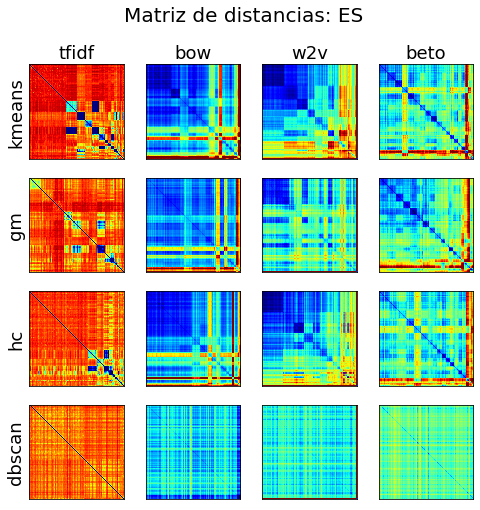

In [12]:
config_p2.plot_dm(es_dm, save=False, lang="ES")

**Observaciones**

De las matrices de distancias, podemos condensar los resultados en 3 grandes hallazgos:
1. *tf-idf genera vectores dispersos*: Regiones rojas, indican que las distancias entre vectores es en promedio grande en comparación a la distancias más pequeña. A diferencia de bow, este otro método acentua alguna de las componentes según su rareza en el corpus de entrenamiento. Esto provoca que las representaciones obtenida sean más *sparse* que el resto.

2. *DBSCAN no logra encontrar clusters:* Que en la diagonal de la matriz de distancias no existan bloques azulados indica que los clusters no estan bien definidos. En particular, los clusters con DBSCAN son solo 2 o 3 (incluso hasta 1) donde los tamaños son exageradamente distintos (clusters con la mayoria de los datos junto a un singleton)

3. *BETO posee un espacio que permite obtener clusters balancedados:* Se observa que la diagonal de bloques es más definida que bow y w2v. Sin embargo, la diferencia con word2vec no es tan clara. Por otro lado, que las estructuras encontradas con BETO sean más homogeneas puede deberse a que el espacio de representaciones (o embeddings) es más rica que incluso word2vec. Esto se debe a que BETO es un modelo del lenguaje pre-entrenado en un extenso corpus en español capaz de capturar estructuras sintacticas y semantica entre palabras. 

#### Proyecciones 2D: ES

En lo que sigue se graficaran los clusters con tres algoritmos de reducción de dimensionalidad. Estos son: UMAP, TSNE y PCA.

In [13]:
es_prjt = config_p2.get_prjt(root_file, es_array_paths, lang="ES")
es_clusters = config_p2.get_clusters(root_file, es_array_paths, lang="ES")

##### PCA: ES

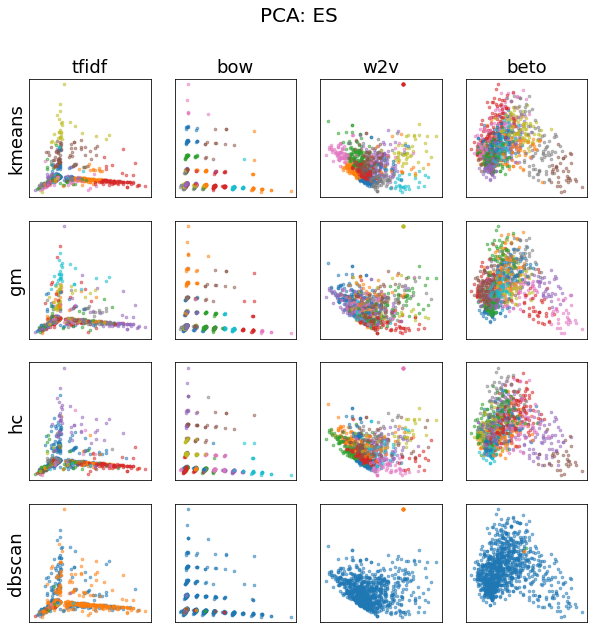

In [14]:
config_p2.plot_prj("pca", es_prjt, es_clusters, save=False, lang="ES")

##### TSNE: ES

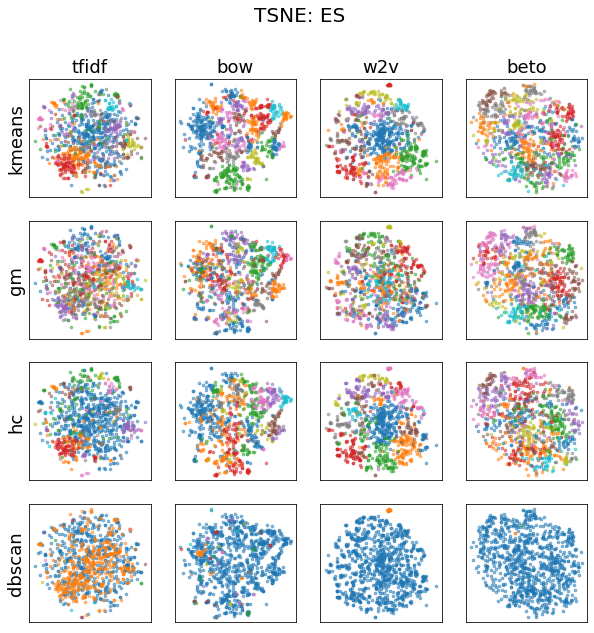

In [15]:
config_p2.plot_prj("tsne", es_prjt, es_clusters, save=False, lang="ES")

##### UMAP: ES

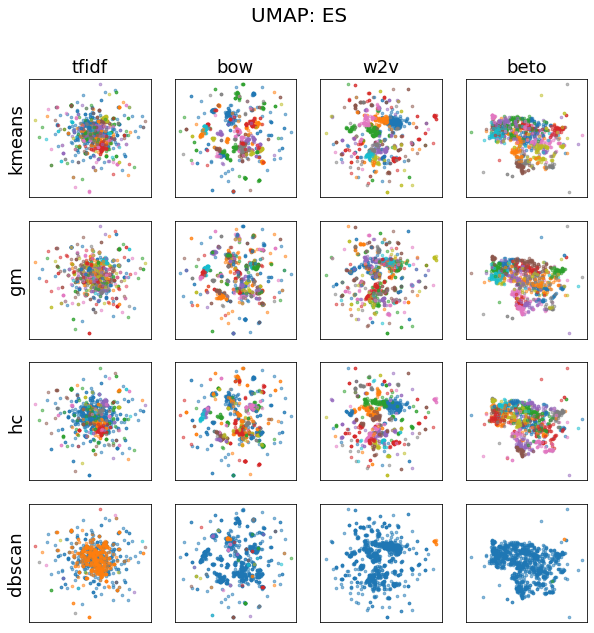

In [16]:
config_p2.plot_prj("umap", es_prjt, es_clusters, save=False, lang="ES")

**Observaciones (generales)**

Condenzaremos los resultados en dos categorias: (1) Diferencias entre métodos de clustering y (2) Diferencias entre los métodos de reducción de dimensionalidad y los espacios generados por cada representaciones de tweets. Con estas categorias, concluiremos sobre cúal de los métodos de clustering y representación de tweets es mejor. 

1. Se observa claramente que DBSCAN no obtiene un buen desempeño en encontrar clusters. En general, el número de clusters encontrados es inferior a tres. Adicionalmente, su desempeño es significativamente menor al resto de métodos de clustering. Estos otros, lograr encontrar clusters que tambien son observables en 2D.

2. En está sección se estudiaron PCA, TSNE y UMAP, para el mismo conjunto de datos. Cada uno de estos algoritmos de reducción de dimensionalidad permiten resaltar caracteristicas de tanto los metodos de clustering como de el espacio de representaciones de tweets. PCA permite capturar la esencia de los espacios de vectores, de donde se observa que tf-idf es un espacio más disperso que bag-of-word. Y estos dos menos compactos que word2vec y BETO. En cambio con TSNE, la nube de puntos (representaciones de los tweets) son indistinguibles. Esto no es una deficiencia, sino que permite compara como se comportan los métodos de clustering en cada espacio vectorial. Por ejemplo, con tf-idf los clusters encontrados no estan bien definidos en comparación a bag-of-word. Y de word2vec con BETO no se observan grandes diferencias. Finalmente, con UMAP se pueden observar simultaneamente las caracteristicas de PCA (esencia del espacio) y TSNE (espacio común). Con está reducción de dimensionalidad, se observa que BETO es un espacio más compacto que el resto y logran observarse clusters pegados pero bien definidos.

## Análisis para Ingles

### Cargar y preparar los resultados: US

*Jupyter notebooks.* En la tabla de abajo se encuentran los notebooks utilizados para obtener los resultados para cada método de representación de tweets en Ingles.

|Representación     |   Notebook (HTML)     |
|----------------------------|-------------|
| BOW                        |[📄](notebooks_clustering/clusterings_usando_bow_US.html)       |
| TF-IDF                     |[📄](notebooks_clustering/clusterings_usando_tfidf_ES.html)       |
| word2vec                   |[📄](notebooks_clustering/clusterings_usando_w2v_US.html)       |
| BERTweet   |[📄](notebooks_clustering/clusterings_usando_bertweet_US.html)|

Cargamos los resultados:

In [17]:
root_file = "/github/data-mining-2022/Hitos/H3/notebooks_clustering"
us_array_paths = config_p2.get_array_paths(root_file, lang="US")
df_us_train, labels_us, sample_index_us = config_p2.get_data("../../Data/train/df_us_train.pickle", lang="US")

### Análisis Cuantitativo: US

En lo que sigue se estudiaran las metricas cuantitativas (Silhouette, Rand score, Mutual information, Completeness, Homogeneity y V-measure) en funcion del método de respresentación de tweets y método de clustering.

In [18]:
df_us_results = config_p2.get_df_results(root_file, us_array_paths, lang="US")

#### Silhouette

In [19]:
config_p2.plot_metric(df_us_results, metric="Silhouette", lang="US")

**Observaciones**

Los resultados obtenidos con DBSCAN son esperables, ya que en general el número de clusters que obtiene automatico varian entre 1 y tres clusters. Por mismo motivo que en español, los clusters que obtiene son mejores definidos e incluso disjuntos en comparacion al resto de metodos de clustering. 

Cuando dejamos de lado a DBSCAN, se observa que bertweet (BERT con tweets en ingles) obtiene mejores valores para GM, HC y KMeans. Por otro lado, podemos notar que con tf-idf, los resultados son pesimos. Lo ultimo se debe a que los clusters obtenidos estan mezclados entre si y no separados ni bien definidos.

#### Rand score

In [20]:
config_p2.plot_metric(df_us_results, metric="Rand score", lang="US")

**Observaciones**

Al igual que para español, se observar que para todos los tipos de representaciones de tweets, el método de clustering DBSCAN posee un Rand score considerablemente menor que el resto de métodos. Esto se debe a que DBSCAN encuentra automaticamente un numero de cluster optimo (2 y 3) menor que el numero de emojis (20 en ingles). Es decir, la mayoria de los tweets son agrupados en no más de tres clusters. Por lo tanto, el numero de pares de elementos en un cluster con DBSCAN que tambien posean un mismo emoji es casi nula. En otras palabras, el numero de pares true-positive es baja. Asi mismo con el numero de pares true-negative.

Ahora bien, cuandos comparamos los otros tres métodos de clustering (gm: Mixturas Gaussianas; hc: Clustering jerarquico aglomerativo ward; KMeans) rescatamos las siguientes observaciones:

1. *Para GM, HC y KMeans el patron de resultados son similares*: BETO es mejor que el resto, luego word2vec (w2v), seguido de bag-of-words (bow) y por ultimo tf-idf (tfidf). Este patron es el mismo que el encontrado para español. Y suponemos que la razon es la misma que antes.

2. *Para las Mixturas Gaussianas los resultados de los distintas representaciones de tweets son similares e incluso mejores que con respecto a HC y Kmeans*: BETO sobresale al resto junto a word2vec. Mientras que bow sutilmente mejor que tfidf. Por misma razon que antes, que los resultados sean mejores que los obtenidos con HC y KMeans se debe a que las mixturas gaussianas permiten obtener otras geometrias de los clusters (distintas de las esfericas), ayudando a que se adecuen mejor a los datos.

#### Mutual information

In [21]:
config_p2.plot_metric(df_us_results, metric="Mutual information", lang="US")

Por mismas razones que antes, dejaremos fuera a DBSCAN. Podemos observar que los resultados son relativamente bajos. Más aún, no es claro si las diferencias entre cada método de clustering y de representacion son estadisticamente significativas. Sin embargo, podemos observar que BERTweet obtiene un MI (normalizado) menor que el resto. Mismo fenomeno que en español. Esto puede deberse a que, al igual que en español, el número de datos por cluster cuando se utiliza BERTweet son más homogeneos que los obtenidos con otras representaciones de los tweets. Este argumento tambien explicar la diferencias con las metricas Rand score, donde se obtiene la conclusion contraria. Dicho fenomeno se debe a que Rand score es una metrica que se recomienda utilizar con clusters balanceados y Mutual information con clusters desbalanceados.

A diferencias de español, esta vez word2vec obtiene los valores más grandes. Esto quiza pueda explicarse con el resto de metricas del analisis.

#### Homogeneity

Cuando pensamos en clasificación, Homogeneity es similar a la Precision de un clasificador. En el caso de clustering no podemos medir la precision, ya que las etiquetas de los clusters son permutables. 

In [22]:
config_p2.plot_metric(df_us_results, metric="Homogeneity", lang="US")

**Observaciones**

Podemos observar que las metricas son bajas. Y las diferencias son graficamente significativas. Sin embargo, para todo tipo de clustering BERTweet es el que obtiene un menor valores Homogenity. Por otro lado, el que tiene mejor valor es word2vec con Kmeans, seguido de HC y GM. A diferencia de los resultados obtenidos con esta metrica en español, esta vez word2vec posee mejor Homogeneity. Esto quiere decir que los métodos de clustering con word2vec son más precision en ingles que en español para clusterizar tweets similares a los emojis. Tal diferencia, queda como futuro trabajo para corroborar si las palabras son menos ambiguas en español que en ingles para cluterizar emojis, o bien, el corpus es ingles es más diverso y permite encontrar clusters más similares a los emojis.
Para evaluar mejor si word2vec sigue siendo mejor, es apropiado ver los falsos-negativos.

#### Completeness

Esta vez, Completeness es similar al Recall de un clasificador. Por lo tanto, poder medir los falsos-negativos del clustering.

In [23]:
config_p2.plot_metric(df_us_results, metric="Completeness", lang="US")

**Observaciones**

Podemos observar que, al igual que en español, el valor es aproximadamente mayor con DBSCAN. Esto se debe a que el número de clusters es cercano a 1 y en el peor de los casos hasta 3. (ver sección de visualización más adelante). Por este motivo, DBSCAN es un método que tiene pocos falsos-negativos en comparación al resto de métodos de clustering.

Adicionalmente, BETO es el que obtiene peor valor. Dicha diferencia es solo de centecimas. Por otro lado, al igual que en la metrica anterior, word2vec destaca por sobre el resto.

#### V-measure

In [24]:
config_p2.plot_metric(df_us_results, metric="V-measure", lang="US")

**Observaciones**

En resumen, podemos observar que ningun método de clustering ni método de representación de tweets obtiene un valor aceptable. Sin embargo, word2vec es el que posee mejor valor para todos los métodos de clustering.

### Análisis Cualitativo: US

#### Matriz de distancias: US

In [25]:
us_dm = config_p2.get_dm(root_file, us_array_paths, lang="US")

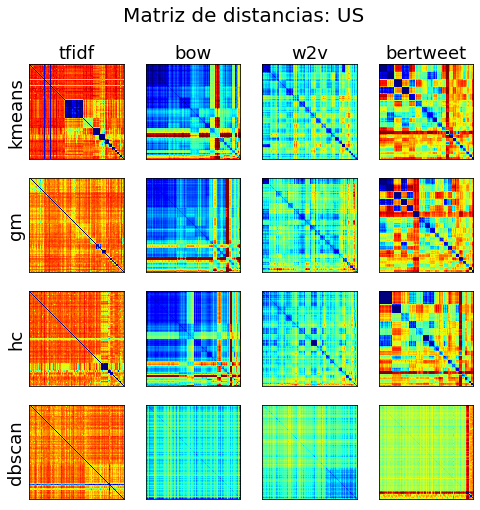

In [26]:
config_p2.plot_dm(us_dm, save=False, lang="US")

**Observaciones**

De las matrices de distancias, podemos condensar los resultados en 4 grandes hallazgos:
1. *tf-idf genera vectores dispersos*: Mismo razonamiento que para español. Regiones rojas, indican que las distancias entre vectores es en promedio grande en comparación a la distancias más pequeña. A diferencia de bow, este otro método acentua alguna de las componentes según su rareza en el corpus de entrenamiento. Esto provoca que las representaciones obtenida sean más *sparse* que el resto.

2. *DBSCAN no logra encontrar clusters:* Que en la diagonal de la matriz de distancias no existan bloques azulados indica que los clusters no estan bien definidos. En particular, los clusters con DBSCAN son solo 2 o 3 (incluso hasta 1) donde los tamaños son exageradamente distintos (clusters con la mayoria de los datos junto a un singleton). Sin embargo, en comparación a español, esta vez existen regiones difusas con colores más frios, es decir, regiones con vectores cercanos.

3. *BETO posee un espacio que permite obtener clusters balancedados:* Se observa que la diagonal de bloques es más definida que bow. Aún mas, la diferencia con word2vec es clara. Por otro lado, que las estructuras encontradas con BETO sean más homogeneas puede deberse a que el espacio de representaciones (o embeddings) es más rica que incluso word2vec. Esto se debe a que BETO es un modelo del lenguaje pre-entrenado en un extenso corpus en español capaz de capturar estructuras sintacticas y semantica entre palabras. 

4. *Diferencias con las matrices en español:* En ingles las matrices de distancias para word2vec y BERTweet (versus BETO) poseen mas regiones rojas que en español. Ademas, word2vec se logra observar una diagonal con bloques azulados. Y en BERTweet contra BETO las diferencias son notorias.

#### Proyecciones 2D: US

In [27]:
us_prjt = config_p2.get_prjt(root_file, us_array_paths, lang="US")
us_clusters = config_p2.get_clusters(root_file, us_array_paths, lang="US")

##### PCA: US

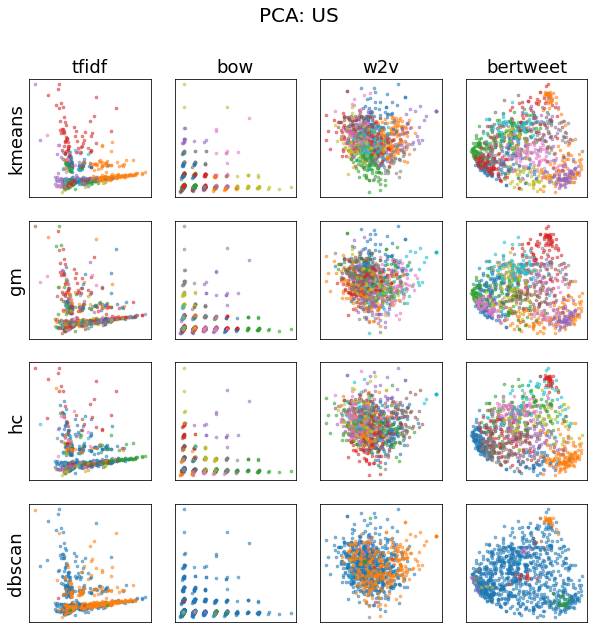

In [28]:
config_p2.plot_prj("pca", us_prjt, us_clusters, save=False, lang="US")

##### TSNE: US

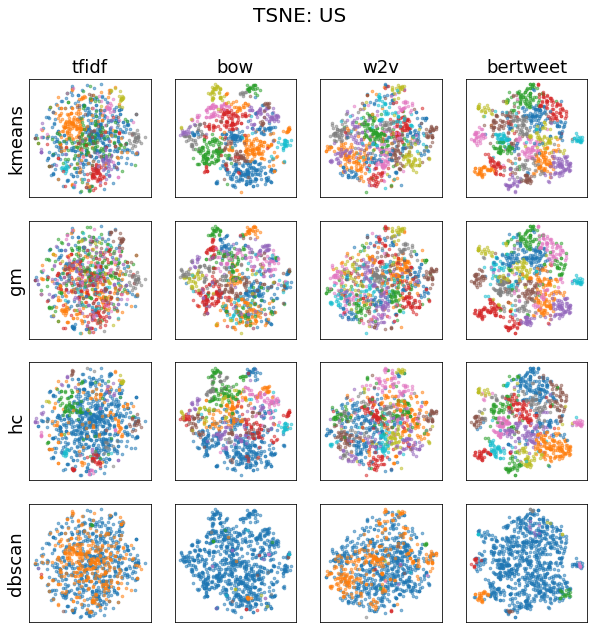

In [29]:
config_p2.plot_prj("tsne", us_prjt, us_clusters, save=False, lang="US")

##### UMAP: US

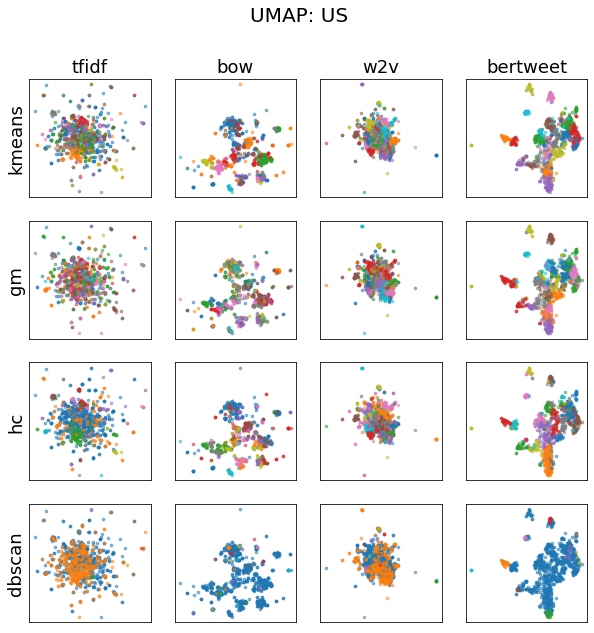

In [30]:
config_p2.plot_prj("umap", us_prjt, us_clusters, save=False, lang="US")

**Observaciones (generales)**

Condenzaremos los resultados en tres categorias: (1) Diferencias entre métodos de clustering y (2) Diferencias entre los métodos de reducción de dimensionalidad y los espacios generados por cada representaciones de tweets y (3) Diferencias y similitudes con los resultados en español. Con estas categorias, concluiremos sobre cúal de los métodos de clustering y representacion de tweets es mejor. 

1. Tal como ocurrio en español, se observa claramente que DBSCAN no obtiene un buen desempeño en encontrar clusters. En general, el número de clusters encontrados es inferior a tres. Sin embargo, en algunos casos llega hasta 11 clusters. Adicionalmente, su desempeño es significativamente menor al resto de métodos de clustering. Estos otros, lograr encontrar clusters que tambien son observables en 2D.

2. En está sección se estudiaron PCA, TSNE y UMAP, para el mismo conjunto de datos. Cada uno de estos algoritmos de reducción de dimensionalidad permiten resaltar caracteristicas de tanto los metodos de clustering como del espacio de representaciones de tweets. PCA permite capturar la esencia de los espacios de vectores, de donde se observa que tf-idf es un espacio más disperso que bag-of-word. Y estos dos menos compactos que word2vec y BETO. En cambio con TSNE, la nube de puntos (representaciones de los tweets) son indistinguibles, salvo con bow y bertweet de donde se observan clusters diferenciados. Adicionalmente, con este método de reducción de dimensionalidad, se observa que con tf-idf los clusters encontrados no estan bien definidos en comparación a bag-of-word. Finalmente, con UMAP se pueden observar simultaneamente las caracteristicas de PCA (esencia del espacio) y TSNE (espacio común). Con está reducción de dimensionalidad, se observa que BETO es un espacio más compacto que el resto y logran observarse tanto clusters pegados pero bien definidos y clusters alejados de una gran nube de puntos.

3. Cuando comparamos los resultados con español podemos observar los siguiente: (PCA) Se obtienen los mismo patrones con tf-idf y bow. Sin embargo, las similitudes no son tan claras cuando comparamos cada idioma con word2vec y BERTweet/BETO; (TSNE) Para los modelos heredados de BERT, se observa que para ingles existen clusters mas definidos que para español; (UMAP) 1. Con tf-idf se observa una macha de puntos indistinguibles entre español e ingles, 2. En español, no se observan diferencias entre bag-of-word y word2vec, pero en ingles existen claras diferencias. 3. En español, las nube de puntos de word2vec posee puntos dispersos en el exterior pero una zona mas densa en el centro, pero en ingles la mayoria de los puntos estan aglomerados en una unica gran bola puntos, 4. Para la representación con el modelo del lenguaje BERT en español (BETO), el espacio de embeddings es compacta sin clusters tan definidos, pero en ingles (BERTweet) la nube se desarma con regiones capaces que formar clusters bien definidos.

## Conclusion 

El objetivo principal es responder si podemos utilizar representaciones vectoriales apropiadas de los tweets y encontrar modelos descriptivos de agrupamiento de datos como clustering capaces de relacionar más aquellos tweets asociados a un mismo emoji. Para esto se establecio una propuesta metodológica con cuatros formas distintas de representar vectorialmente un tweet y cinco métodos distintos de clustering. Las representaciónes vectoriales van desde tecnicas tradicionales con bag-of-word (bow) y tf-idf (term-frecuency/inverse-document-frecuency) hasta tecnicas más sofisticadas con word2vec y BERT (BETO en españo y BERTweet en ingles). Los métodos de clustering propuestos fueron KMeans, Mixturas gaussianas, Clustering jerarquico aglomerativo (ward), OPTICS y DBSCAN. Donde los ultimos dos, son lo unicos de los cinco que encuentran el número optimo de clusters de forma automatica. Para el resto de métodos se utilizan tantos clusters como emojis (19 en español y 20 en ingles).

Para poder responder la pregunta se consideraron tanto metricas cuantitativas como cualitativas. Para las de primer tipo, las metricas utilizadas fueron Silhouette, Rand score, Mutual information, Homogeneity, Completeness y V-measure. Donde las la primera es una metrica que solo utiliza los clusters y el resto requiere de las etiquetas (en este caso el emoji asociado al tweet). Para las metricas de segundo tipo, se visualizo la matriz de distancias y una proyección en 2D con tres algoritmos de reducción de dimensionalidad (PCA, TSNE y UMAP).

Este analisis ser realizo en paralelo para los dos idiomas del dataset, Ingles y Español.

De los resultados obtenidos, concluimos que encontrar buenas representaciones y métodos de clustering capaces de encontrar mismo grupos que los emojis para cada tweet es una tarea dificil. Según las metricas propuestas, no existio una buena combinaciones de vectores para los tweets ni clusters. Esto ocurre tanto para español como para ingles. Adicionalmente, los resultados obtenidos se compararon con metricas obtenidas por modelos aleatorios de etiquetado de datos. Dichos resultados indican que los métodos utilizados no superaban significativamente a modelo que realizan la misma tarea de forma azarosa.

Por otro lado, por problemas de capacidad computacional (memoria) no se pudieron utilizar todos lo métodos de clustering propuestos, dejando de lado el método clusterización OPTICS, el cual podria haber entregarnos resultados diferentes a los obtenidos en el desarrollo de esta pregunta.